<a href="https://colab.research.google.com/github/Jacquelinepersha/BuildingPermits/blob/main/artificial_neural_networks_basics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

https://jonathanweisberg.org/post/A%20Neural%20Network%20from%20Scratch%20-%20Part%201/

https://developer.ibm.com/technologies/artificial-intelligence/articles/neural-networks-from-scratch/

https://medium.com/analytics-vidhya/artificial-neural-network-from-scratch-using-python-numpy-580e9bacd67c

https://www.analyticsvidhya.com/blog/2020/07/neural-networks-from-scratch-in-python-and-r/

# **Introduction to Neural Networks**

The diagram below shows a cartoon drawing of a biological neuron (left) and a common mathematical model (right).

In [ ]:
from IPython.display import Image

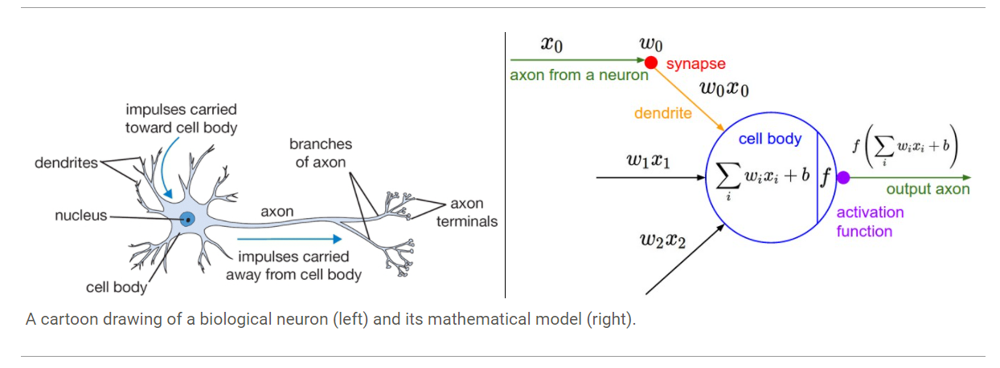

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/NN_Architecture_Image.PNG')
# https://cs231n.github.io/neural-networks-1/

Neural Networks are modeled as collections of neurons that are connected in an acyclic graph. In other words, the outputs of some neurons can become inputs to other neurons.Neural Network models are often organized into distinct layers of neurons.For regular neural networks, the most common layer type is the **fully-connected layer (Dense Layer)** in which neurons between two adjacent layers are fully pairwise connected, but neurons within a **single layer** share **no connections.** Below are two example Neural Network topologies that use a stack of fully-connected layers -

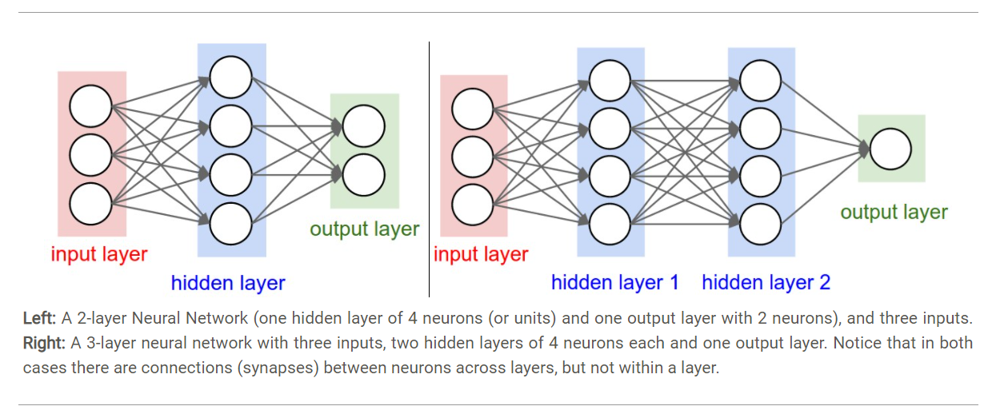

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/NN_Architecture_II_Image.PNG')
# https://cs231n.github.io/neural-networks-1/

**Naming conventions**: Notice that when we say N-layer neural network, we do not count the input layer. Therefore, a single-layer neural network describes a network with no hidden layers (input directly mapped to output). In that sense, you can sometimes hear people say that logistic regression or SVMs are simply a special case of single-layer Neural Networks. You may also hear these networks interchangeably referred to as “Artificial Neural Networks” (ANN) or “Multi-Layer Perceptrons” (MLP).

**Output layer:** Unlike all layers in a Neural Network, the output layer neurons most commonly do not have an activation function (or you can think of them as having a linear identity activation function). This is because the last output layer is usually taken to represent the class scores (e.g. in classification), which are arbitrary real-valued numbers, or some kind of real-valued target (e.g. in regression).

**Neurons:** As explained above, neurons are calculated by taking some linear or non-linear combination of inputs from previous layers (shown in NN matrix architecture below).

**Sizing neural networks:** The two metrics that people commonly use to measure the size of neural networks are the number of neurons, or more commonly the number of parameters. Working with the two example networks in the above picture:

1.   The first network (left) has 4 + 2 = 6 neurons (not counting the inputs), [3 x 4] + [4 x 2] = 20 weights and 4 + 2 = 6 biases, for a total of 26 learnable parameters.
2.   The second network (right) has 4 + 4 + 1 = 9 neurons, [3 x 4] + [4 x 4] + [4 x 1] = 12 + 16 + 4 = 32 weights and 4 + 4 + 1 = 9 biases, for a total of 41 learnable parameters

modern Neural Networks contain on orders of 100 million parameters and are usually made up of approximately 10-20 layers (hence deep learning). However, as we will see the number of effective connections is significantly greater due to parameter sharing.

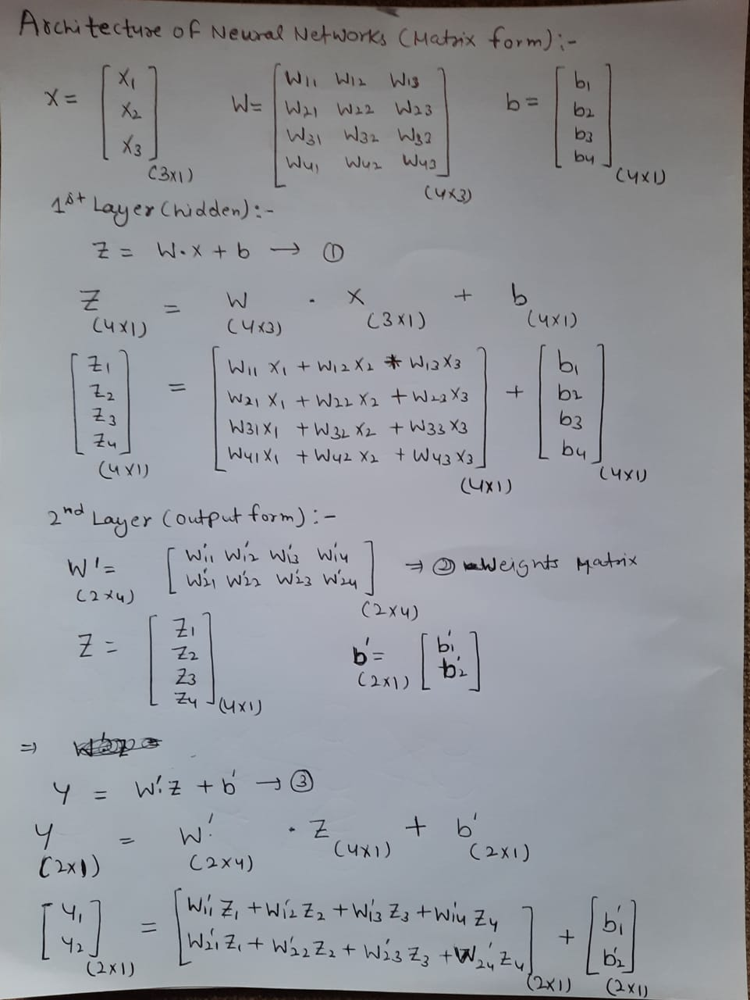

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/NN_matrix_architecture.jpeg',width=800,height=700)
# for the left side network architecture above. Similar structure can be drawn for right side network image

## **Activation Functions**


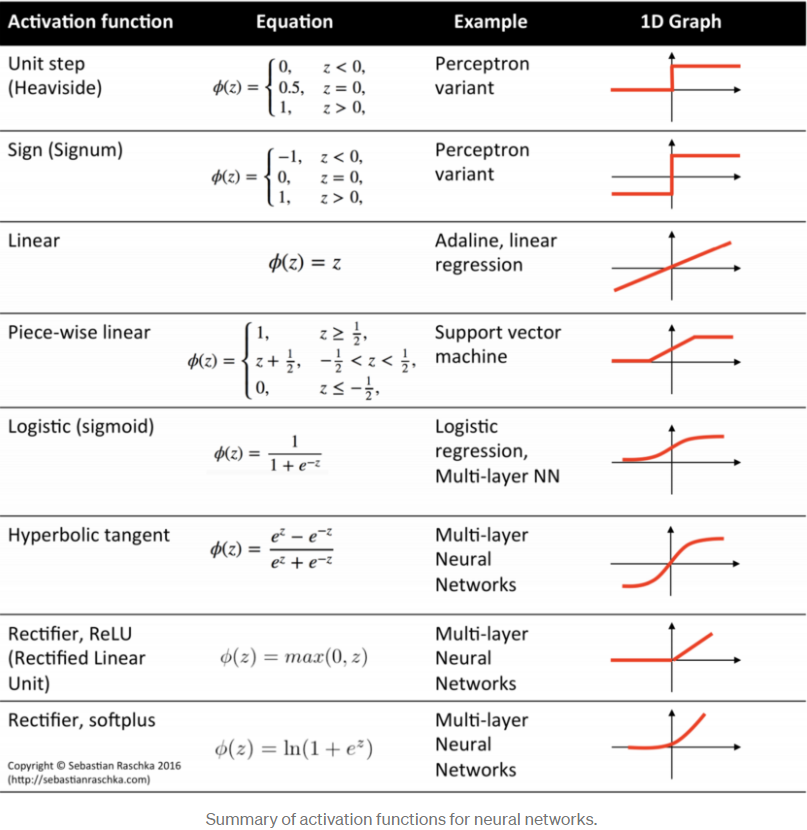

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/Activation_Function_summary.PNG',width=800, height=700)

**What:**
With the linear combination, we apply some function (called the activation function) to achieve our eventual output. Common examples of these functions are:

The activation function should do two things:
1.   Ensures not linearity since there are benefits to using non-linear functions
2.   Ensure gradients remain large through the hidden unit - important feature of an activation function is that it should be differentiable.This is necessary in order to perform backpropagation in the network, to compute gradients of error (loss) with respect to the weights which are then updated using gradient descent.

If we have small gradients and several hidden layers, these gradients will be multiplied during backpropagation. Computers have limitations on the precision to which they can work with numbers, and hence if we multiply many very small numbers, the value of the gradient will quickly vanish. This is commonly known as the **vanishing gradient problem** and is an important challenge when generating deep neural networks

Some of the most common choices for activation function are:
*   Sigmoid
*   ReLU (rectified linear unit)
*   Leaky ReLU
*   Generalized ReLU
*   MaxOut
*   Softplus
*   Tanh
*   Swish

**Sigmoid Function** (A function which ‘squeezes’ all the initial output to be between 0 and 1). -
*   Sigmoids suffer from the vanishing gradient problem.
*   Sigmoids are not zero centered; gradient updates go too far in different directions, making optimization more difficult.
*   Sigmoids saturate and kill gradients.
*   Sigmoids have slow convergence.

**tanh Function** (A function which ‘squeezes’ all the initial output to be between -1 and 1). The zero centeredness issue of the sigmoid function can be resolved by using the hyperbolic tangent function.Because of this, the hyperbolic tangent function is always preferred to the sigmoid function within hidden layers.

**ReLU Function** (If the initial output is negative, then output 0. If not, do nothing to the initial output). ReLU avoids and rectifies the vanishing gradient problem. Almost all deep learning Models use ReLU nowadays. However, ReLU should only be used within hidden layers of a neural network, and not for the output layer — which should be sigmoid for binary classification, softmax for multiclass classification, and linear for a regression problem.

One of the main problems with ReLU that gives rise to the vanishing gradient problem is that its derivative is zero for half of the values of the input x. This is problematic as it can result in a large proportion of dead neurons (as high as 40%) in the neural network. Swish, on the other hand, is a smooth non-monotonic function that does not suffer from this problem of zero derivatives.

The leaky and generalized rectified linear unit are slight variations on the basic ReLU function.

## **Loss Functions**

Loss functions are required to estimate the model error.

There are many functions that could be used to estimate the error of a set of weights in a neural network. However, we prefer a function where the space of candidate solutions maps onto a smooth (but high-dimensional) landscape that the optimization algorithm can reasonably navigate via iterative updates to the model weights.

**Maximum Likelihood** approach provides a framework for choosing a loss function when training neural networks and machine learning models in general.

**Cross-entropy** and **mean squared error** are the two main types of loss functions to use when training neural network models.


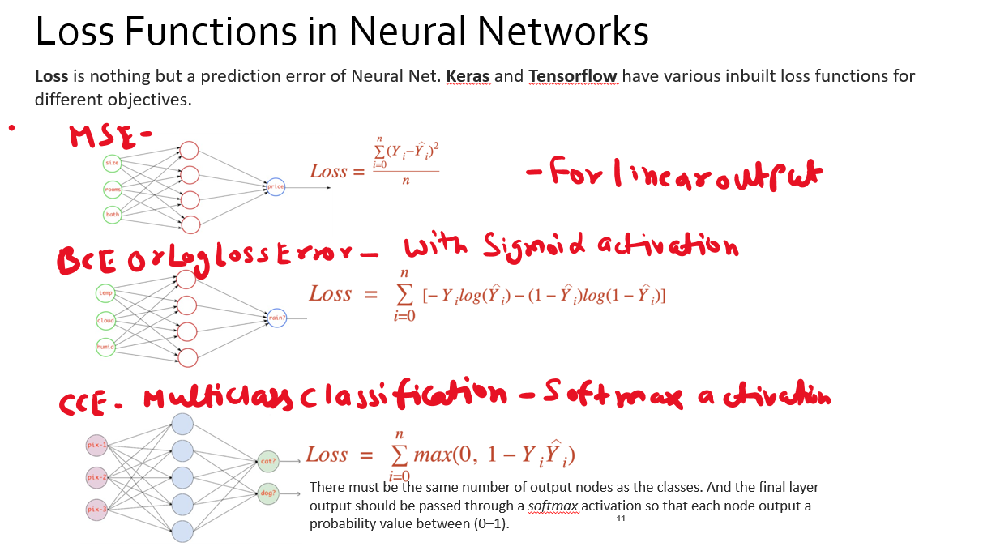

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/Loss_functions.PNG',width=800, height=400)

## **Output Units**

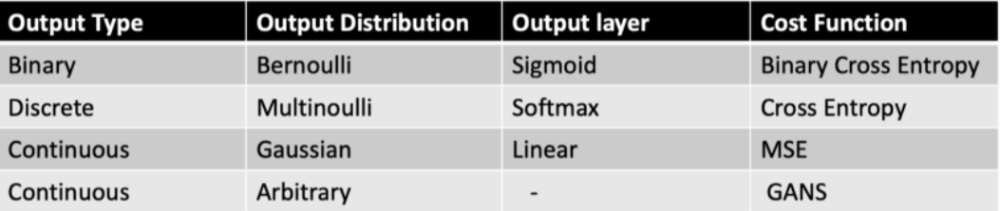

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/output_functions.PNG',width=800, height=200)

It is relatively easy to forget to use the correct output function and spend hours troubleshooting an underperforming network.

For binary classification problems, such as determining whether a hospital patient has cancer (y=1) or does not have cancer (y=0), the **sigmoid function** is used as the output.

For multiclass classification, such as a dataset where we are trying to filter images into the categories of dogs, cats, and humans. This uses the multidimensional generalization of the sigmoid function, known as the **softmax function**.

There are also specific loss functions that should be used in each of these scenarios, which are compatible with the output type. For example, using MSE on binary data makes very little sense, and hence for binary data, we use the binary cross entropy loss function.

## **Backpropagation**

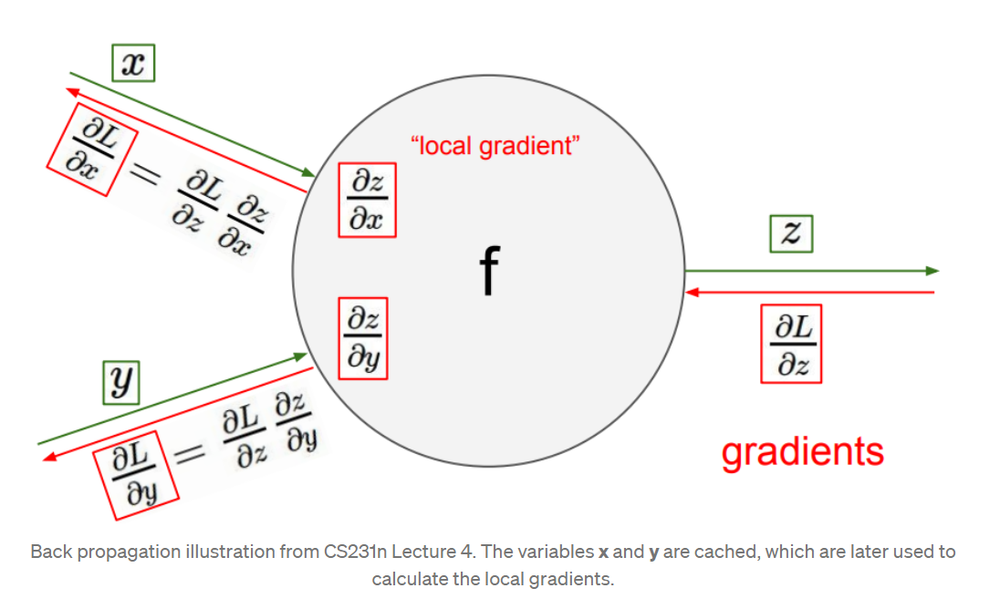

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/Gradient_derivation.PNG',width=800, height=400)

Backpropagation is the central mechanism by which neural networks learn. Backpropagation is the way in which we calculate the derivatives for each of the parameters in the network, which is necessary in order to perform gradient descent.**Backpropagation is performed first in order to gain the information necessary to perform gradient descent.**

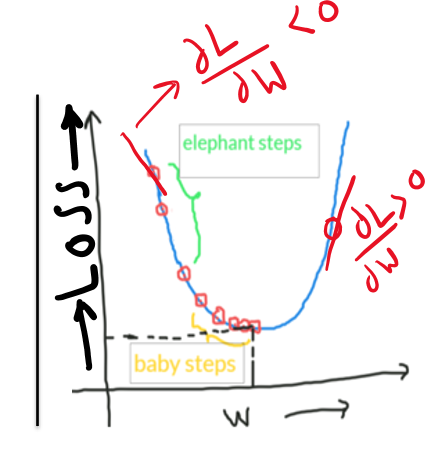

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/GD_Image.PNG',width=400, height=400)

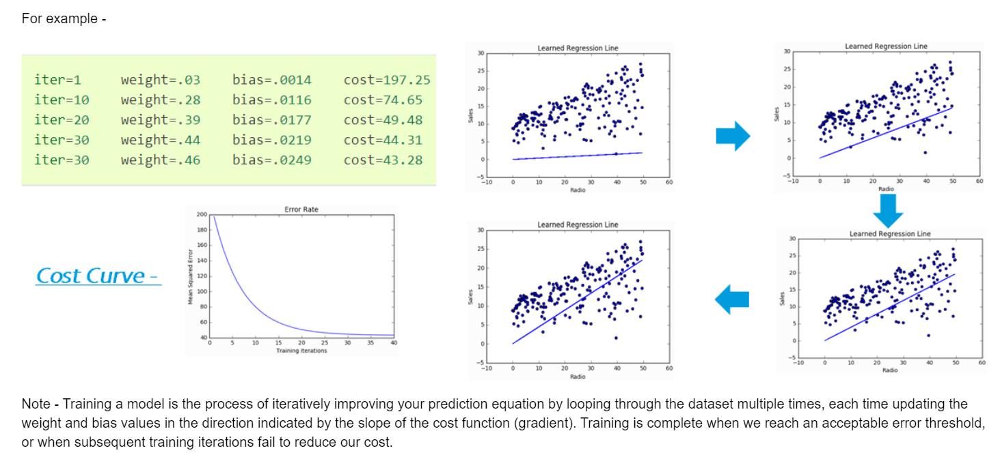

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/Gradient_descent_image.PNG',width=800, height=400)

**Steps to perform Gradient Descent**

*   Initialize with weight and bias values 0 and a very small learning rate - 0.0001 (it can be any other value as well)
*   Calculate the partial derivatives of the cost function wrt to weight and bias - (Refer to hand notes)
*   Update the weights and bias using the equation as suggested in hand notes
*   Repeat this process until & unless it converges to minimum or ideally 0

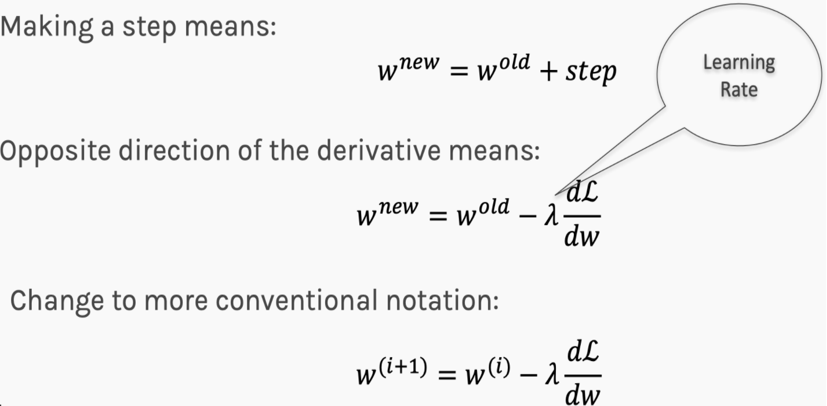

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/GD_Update_rule_Image.PNG',width=500, height=300)

## **NN Architecture - Number of Neurons and Layers**

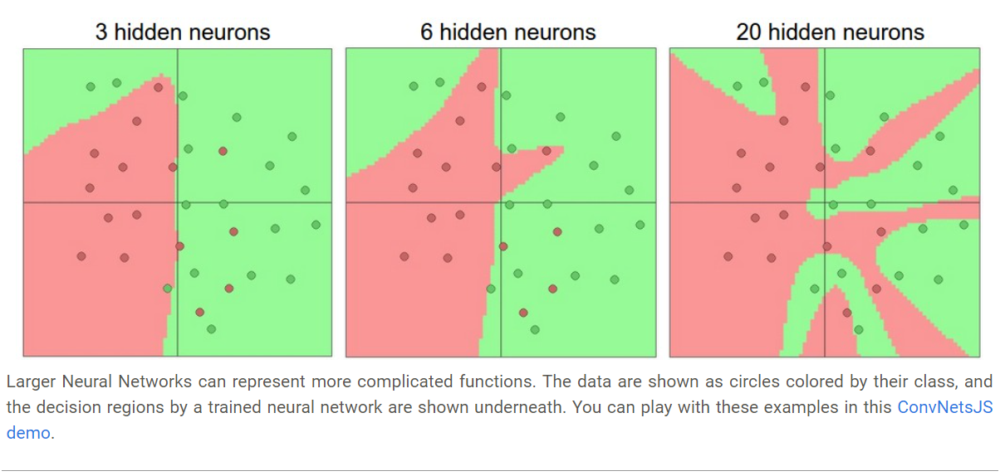

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/neurons_size.PNG',width=800, height=300)

**Setting number of layers and their sizes**

How do we decide on what architecture to use when faced with a practical problem? Should we use no hidden layers? One hidden layer? Two hidden layers? How large should each layer be? First, note that as we increase the size and number of layers in a Neural Network, the capacity of the network increases.

Neural Networks with more neurons can express more complicated functions. However, this is both a blessing (since we can learn to classify more complicated data) and a curse (since it is easier to overfit the training data). Overfitting occurs when a model with high capacity fits the noise in the data instead of the (assumed) underlying relationship. For example, the model with 20 hidden neurons fits all the training data but at the cost of segmenting the space into many disjoint red and green decision regions. The model with 3 hidden neurons only has the representational power to classify the data in broad strokes. It models the data as two blobs and interprets the few red points inside the green cluster as outliers (noise). In practice, this could lead to better generalization on the test set.

it seems that smaller neural networks can be preferred if the data is not complex enough to prevent overfitting. However, this is incorrect - there are many other preferred ways to prevent overfitting in Neural Networks that we will discuss later **(such as L2 regularization, dropout, input noise). In practice, it is always better to use these methods to control overfitting instead of the number of neurons.**

The takeaway is that you should not be using smaller networks because you are afraid of overfitting. Instead, you should use as big of a neural network as your computational budget allows, and use other regularization techniques to control overfitting.

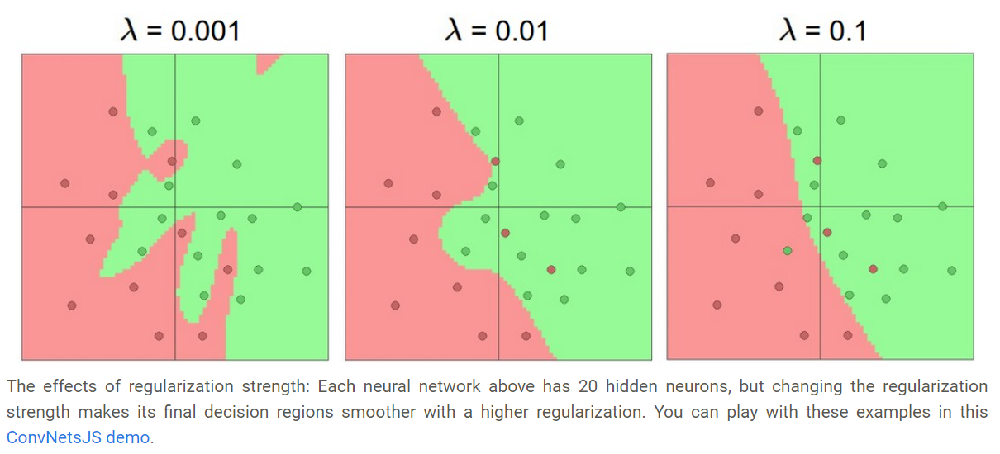

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/learning_rates.PNG',width=800, height=300)

Choosing architectures for neural networks is not an easy task. We want to select a network architecture that is large enough to approximate the function of interest, but not too large that it takes an excessive amount of time to train. Another issue with large networks is that they require large amounts of data to train — you cannot train a neural network on a hundred data samples and expect it to get 99% accuracy on an unseen data set.
In general, it is good practice to use multiple hidden layers as well as multiple nodes within the hidden layers, as these seem to result in the best performance.

## **Challenges with Optimizers**

**What is a reasonable learning rate to use?** Too small a learning rate takes too long to converge, and too large a learning rate will mean that the network will not converge.

**How do we avoid getting stuck in local optima?** One local optimum may be surrounded by a particularly steep loss function, and it may be difficult to ‘escape’ this local optimum.

**What if the loss surface morphology changes?** Even if we can find the global minimum, there is no guarantee that it will remain the global minimum indefinitely. A good example of this is when training on a dataset that is not representative of the actual data distribution — when applied to new data, the loss surface will different. This is one reason why trying to make the training and test datasets representative of the total data distribution is of such high importance. Another good example is data which habitually changes in distribution due to its dynamic nature — an **example of this would be user preferences for popular music or movies, which changes day-to-day and month-to-month.**

**Local Optima**
Previously, local minima were viewed as a major problem in neural network training. Nowadays, researchers have found that when using sufficiently large neural networks, most local minima incur a low cost, and thus it is not particularly important to find the true global minimum — a local minimum with reasonably low error is acceptable.

**Vanishing/Exploding Gradients** There are additional issues associated with the architecture of the neural network.

**Momentum** Momentum is an added term in the objective function, which is a value between 0 and 1 that increases the size of the steps taken towards the minimum by trying to jump from a local minimum.If the momentum term is large then the learning rate should be kept smaller. A large value of momentum also means that the convergence will happen fast. But if both the momentum and learning rate are kept at large values, then you might skip the minimum with a huge step.A right value of momentum can be either learned by hit and trial or through cross-validation.

**Adam** is a combination of RMSprop and momentum (similarly, Nadam refers to a combination of RMSprop and Nesterov momentum). Adam refers to adaptive moment estimation, and it is the most popular optimizer used for neural networks today.

Adam computes adaptive learning rates for each parameter. In addition to storing an exponentially decaying average of past squared gradients vt like Adadelta and RMSprop, Adam also keeps an exponentially decaying average of past gradients, similar to momentum.

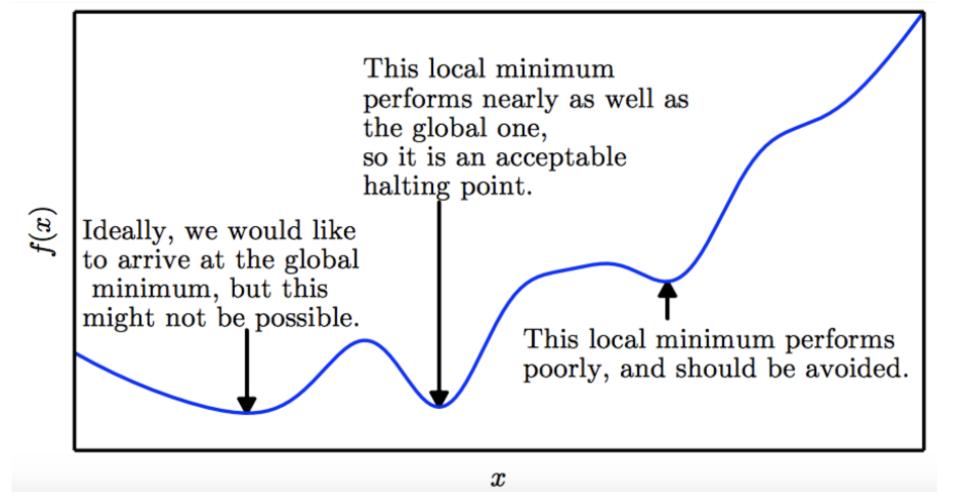

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/local_global_optima.PNG',width=700, height=300)

## **Approaches towards handling above challenges**


**Parameter Initialization** a network that we initialize with all values of zero. What would happen in this scenario? The network would actually not learn anything at all. Even after a gradient update, all the weights would still be zero, because of the inherent way we are calculating the gradient updates.

What should be the scale of this initialization? If we choose large values for the weights, this can lead to exploding gradients. On the other hand, small values for weights can lead to vanishing gradients. There is some sweet spot that provides the optimum tradeoff between these two, but it cannot be known a priori and must be inferred through trial and error.

1.   **Xavier Initialization** Xavier initialization is a simple heuristic for assigning network weights. With each passing layer,

2.   **He Normal Initialization**
3.   **Bias Initialization**
4.   **Pre-Initialization**

**Batch Normalization** Up to this point, we have looked at ways to navigate the loss surface of the neural network using momentum and adaptive learning rates. We have also look at several methods of parameter initialization in order to minimize a priori biases within the network. In this section, we will look at how we can manipulate the data itself in order to aid our model optimization.

According to the paper “Batch Normalization: Accelerating Deep Network Training by Reducing Internal Covariate Shift”, gradient descent converges much faster with feature scaling than without it.

Batch normalization is an extension to the idea of feature standardization to other layers of the neural network.** If the input layer can benefit from standardization, why not the rest of the network layers?**

To increase the stability of a neural network, batch normalization normalizes the output of a previous activation layer by subtracting the batch mean and dividing by the batch standard deviation.

There are several advantages to using batch normalization:
1. Reduces internal covariant shift.
2. Reduces the dependence of gradients on the scale of the parameters or their initial values.
3. Regularizes the model and reduces the need for dropout, photometric distortions, local response normalization and other regularization techniques.
4. Allows use of saturating nonlinearities and higher learning rates.



## **Regualrization - How to address overfitting**

**Pruning**
Model pruning seeks to induce sparsity in a deep neural network’s various connection matrices, thereby reducing the number of nonzero-valued parameters in the model.

**Weights in a neural network that are considered unimportant or rarely fire can be removed from the network with little to no consequence. In fact, the majority of neurons have a relatively small impact on the model performance, meaning we can achieve high accuracy even when eliminating large numbers of parameters.**

Reducing the number of parameters in a network becomes increasingly important as neural architectures and datasets get larger in order to obtain reasonable execution times of models.

The research paper “To prune, or not to prune: exploring the efficacy of pruning for model compression” examined the performance of neural networks as a function of sparsity (effectively the percentage of neurons removed) and found that even when reducing 75% of the neurons in a network, the model performance was not affected significantly. Indeed, halving the number of parameters only reduced the accuracy by 0.1%.

Pruning is typically done in convolutional neural networks, however, since the majority of parameters in convolutional models occur in the fully connected (vanilla) neural layers, most of the parameters are eliminated from this portion of the network.

**Learning Rate**

**SGD with Warm Restarts**
Warm restarts are a very simple idea: restart the learning after a specified number of epochs. For example, the learning rate starts at 0.1 initially and decreases exponentially over time. After 30 iterations, the learning rate scheduler resets the learning rate to the same value as epoch 1, and then the learning rate scheduler repeats the same exponentially decay. The best estimates are recorded each time before the learning rate is reset.

It is important to note that the restarts are not from scratch, but from the last estimate, and the learning rate is increased. Thus, restarts provide most of the same benefits as cyclical learning rates, such as being able to escape extreme local minima.


**Estimators**

**Dropout** It is a regularization technique for deep neural networks. It is employed at training time and eliminates the output of some units randomly. This helps to prevent the network from relying on individual neurons too much, which helps to prevent overfitting. Instead, the knowledge is spread across all of the neurons to help obtain a more robust network. At testing time, all of the neurons are present and their firing probability is scaled since there are more neurons than previously present at training time.

**Purpose:** prevent the co-adaptation of feature detectors for a set of neurons, and avoid overfitting.

It enforces the neurons to develop an individual role on their own given an overall population behavior.
Training weights are encouraged to be spread across the neural network because no neuron is permanent.

**Interpretation:** training examples provide gradients from different, randomly sampled architectures.

**Direct implementation:**

At training time: eliminate the output of some units randomly.

At test time: all units are present.

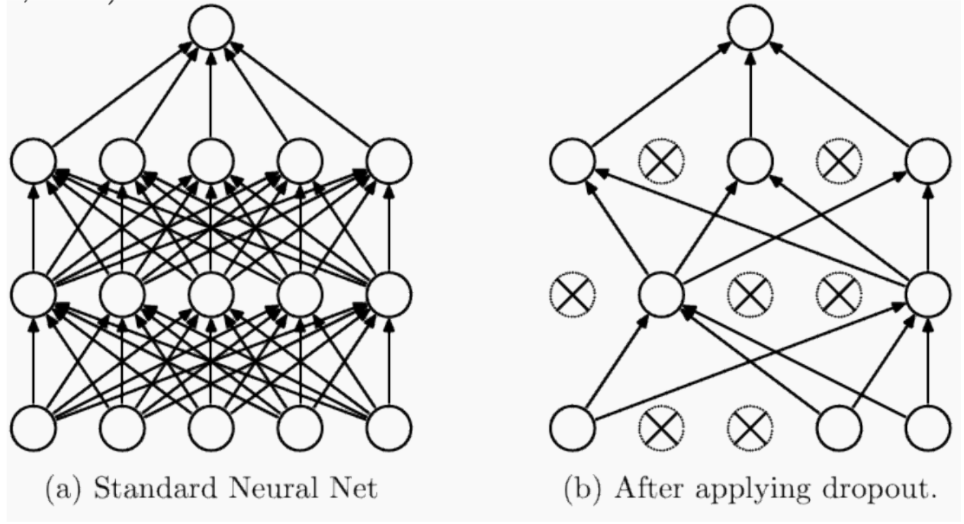

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/Dropout.PNG',width=700, height=300)

# **Model Building in Tensorflow - MNIST Dataset**

**What is MNIST?**

MNIST contains 70,000 images of hand-written single digits between 0 and 9, each image is 28 x 28 pixels in greyscale with pixel-values from 0 to 255.

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
mnist = tf.keras.datasets.mnist
# fix random seed for reproducibility
np.random.seed(5)
(X_train_full, y_train_full), (X_test, y_test) = mnist.load_data()

In [ ]:
print(f"data type of X_train: {X_train_full.dtype},\nshape of X_train_full: {X_train_full.shape}")
print(f"data type of X_train: {X_test.dtype},\nshape of X_train_full: {X_test.shape}")

data type of X_train: uint8,
shape of X_train_full: (60000, 28, 28)
data type of X_train: uint8,
shape of X_train_full: (10000, 28, 28)


In [ ]:
# create a validation data set from the full training data
# Scale the data between 0 to 1 by dividing it by 255. as its an unsigned data between 0-255 range
X_valid, X_train = X_train_full[:5000] / 255., X_train_full[5000:] / 255.
y_valid, y_train = y_train_full[:5000], y_train_full[5000:]

# scale the test set as well
X_test = X_test / 255.

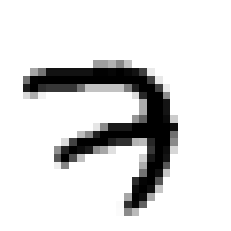

In [ ]:
# lets view the first data point of X_train
plt.imshow(X_train[0], cmap="binary")
plt.axis('off')
plt.show()

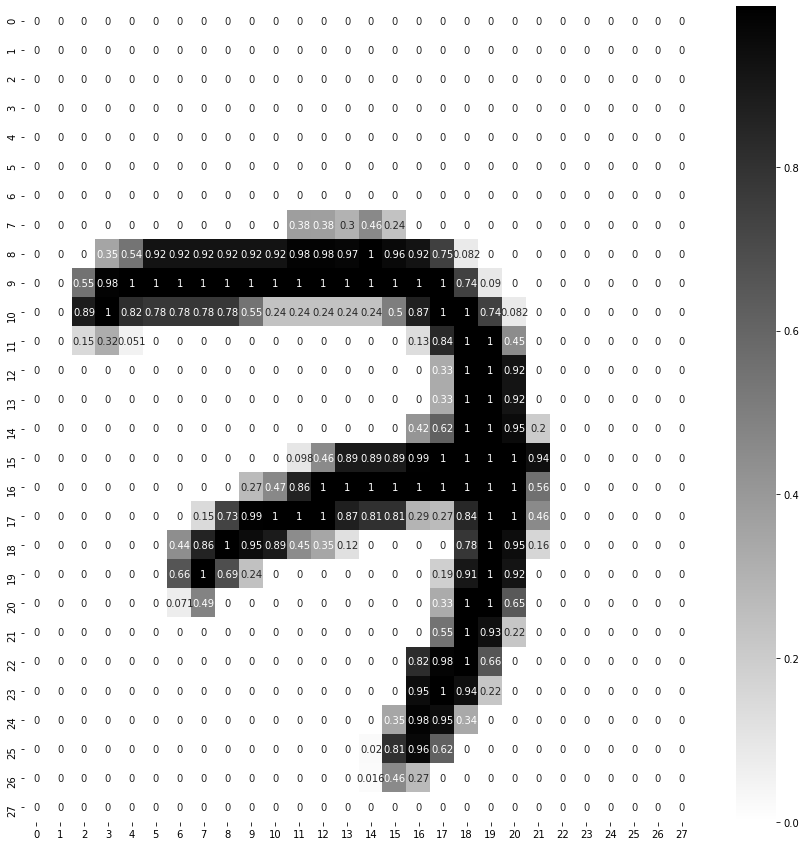

In [ ]:
plt.figure(figsize=(15,15))
sns.heatmap(X_train[0], annot=True, cmap="binary")

In [ ]:
# actual value of y_train
y_train[0]

7

In [ ]:
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Flatten(input_shape=[28, 28])) # Input layer
model.add(tf.keras.layers.Dense(300, activation="relu"))
model.add(tf.keras.layers.Dense(100, activation="relu"))
model.add(tf.keras.layers.Dense(10, activation="softmax"))

# model = tf.keras.Sequential([
#     Flatten(input_shape=(28, 28)),
#     Dense(128, activation='sigmoid'),
#     Dense(64, activation='sigmoid'),
#     Dense(10)
# ])

In [ ]:
model.layers

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 784)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 300)               235500    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               30100     
_________________________________________________________________
dense_5 (Dense)              (None, 10)                1010      
Total params: 266,610
Trainable params: 266,610
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# firsLayer * secondLayer + bias
784*300 + 300, 300*100 + 100, 100*10 + 10

(235500, 30100, 1010)

In [ ]:
# Total parameters to be trained -
sum((235500, 30100, 1010))

266610

In [ ]:
hidden1 = model.layers[1]
hidden1.name
model.get_layer(hidden1.name) is hidden1

True

In [ ]:
hidden1.get_weights()

[array([[ 7.2692961e-02, -5.9923030e-02, -4.0352058e-02, ...,
          4.5492023e-02, -5.7890963e-02,  1.9952804e-03],
        [-1.7905265e-02, -3.1016856e-02,  6.9783613e-02, ...,
         -5.9587535e-02, -5.7161368e-02,  4.3021217e-02],
        [ 5.2395940e-02, -1.4383554e-02, -3.4959588e-02, ...,
         -5.9855748e-02, -5.4124117e-02,  7.2607666e-02],
        ...,
        [ 1.2033507e-03,  5.1443279e-04,  3.8285278e-02, ...,
          3.0062348e-04, -7.1440697e-02,  5.4505035e-02],
        [ 2.0485967e-03, -5.3515427e-02,  6.5640643e-02, ...,
         -6.3600883e-02, -5.9546027e-02, -6.4634874e-02],
        [ 2.4834163e-02, -7.4356087e-02, -5.7846367e-02, ...,
         -5.4381385e-02,  1.8961728e-05, -6.0168378e-02]], dtype=float32),
 array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0.

In [ ]:
weights, biases = hidden1.get_weights()

In [ ]:
print("shape\n",weights.shape, "\n")
weights

shape
 (784, 300) 



array([[ 7.2692961e-02, -5.9923030e-02, -4.0352058e-02, ...,
         4.5492023e-02, -5.7890963e-02,  1.9952804e-03],
       [-1.7905265e-02, -3.1016856e-02,  6.9783613e-02, ...,
        -5.9587535e-02, -5.7161368e-02,  4.3021217e-02],
       [ 5.2395940e-02, -1.4383554e-02, -3.4959588e-02, ...,
        -5.9855748e-02, -5.4124117e-02,  7.2607666e-02],
       ...,
       [ 1.2033507e-03,  5.1443279e-04,  3.8285278e-02, ...,
         3.0062348e-04, -7.1440697e-02,  5.4505035e-02],
       [ 2.0485967e-03, -5.3515427e-02,  6.5640643e-02, ...,
        -6.3600883e-02, -5.9546027e-02, -6.4634874e-02],
       [ 2.4834163e-02, -7.4356087e-02, -5.7846367e-02, ...,
        -5.4381385e-02,  1.8961728e-05, -6.0168378e-02]], dtype=float32)

In [ ]:
print("shape\n", biases.shape)
biases

shape
 (300,)


array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.

In [ ]:
%%time
loss_function = "sparse_categorical_crossentropy" # use => tf.losses.sparse_categorical_crossentropy
optimizer = "SGD" # or use with custom learning rate=> tf.keras.optimizers.SGD(0.02)
metrics = ["accuracy"]

model.compile(loss=loss_function,
              optimizer=optimizer,
              metrics=metrics)

# model.fit(X_train, y_train, epochs=30)

CPU times: user 9.3 ms, sys: 21 µs, total: 9.32 ms
Wall time: 9.09 ms


In [ ]:
print(X_train.shape)
print(y_train.shape)
print(X_valid.shape)
print(y_valid.shape)

(55000, 28, 28)
(55000,)
(5000, 28, 28)
(5000,)


In [ ]:
# with validation dataset
valid_set = (X_valid, y_valid)
history = model.fit(X_train,
                    y_train,
                    epochs = 10,
                    validation_data = valid_set)

Epoch 1/10
1719/1719 [==============================] - 7s 2ms/step - loss: 0.9930 - accuracy: 0.7371 - val_loss: 0.3023 - val_accuracy: 0.9150
Epoch 2/10
1719/1719 [==============================] - 3s 2ms/step - loss: 0.2959 - accuracy: 0.9164 - val_loss: 0.2369 - val_accuracy: 0.9356
Epoch 3/10
1719/1719 [==============================] - 3s 2ms/step - loss: 0.2457 - accuracy: 0.9313 - val_loss: 0.2033 - val_accuracy: 0.9444
Epoch 4/10
1719/1719 [==============================] - 3s 2ms/step - loss: 0.2047 - accuracy: 0.9410 - val_loss: 0.1775 - val_accuracy: 0.9496
Epoch 5/10
1719/1719 [==============================] - 3s 2ms/step - loss: 0.1792 - accuracy: 0.9479 - val_loss: 0.1595 - val_accuracy: 0.9578
Epoch 6/10
1719/1719 [==============================] - 3s 2ms/step - loss: 0.1535 - accuracy: 0.9554 - val_loss: 0.1460 - val_accuracy: 0.9592
Epoch 7/10
1719/1719 [==============================] - 3s 2ms/step - loss: 0.1392 - accuracy: 0.9612 - val_loss: 0.1363 - val_accuracy:

X_train.shape, 55000/32, batch size=32 by default

In [ ]:
import time
import os

def saveModel_path(model_dir="saved_models"):
    os.makedirs(model_dir, exist_ok=True)
    fileName = time.strftime("Model_%Y_%m_%d_%H_%M_%S_.h5")
    model_path = os.path.join(model_dir, fileName)
    print(f"your model will be saved at the following location\n{model_path}")
    return model_path

In [ ]:
unique_path = model.save(saveModel_path())
unique_path

your model will be saved at the following location
saved_models/Model_2021_05_24_03_04_42_.h5


In [ ]:
# loaded_model = tf.keras.models.load_model("saved_model/Model_2021_05_23_03_43_03_.h5")

In [ ]:
history.params

{'epochs': 10, 'steps': 1719, 'verbose': 1}

In [ ]:
import pandas as pd
pd.DataFrame(history.history)

,loss,accuracy,val_loss,val_accuracy
0,0.592589,0.846727,0.302252,0.9150
1,0.284997,0.919109,0.236932,0.9356
2,0.233659,0.933818,0.203308,0.9444
3,0.199753,0.943055,0.177491,0.9496
4,0.174728,0.950236,0.159458,0.9578
5,0.154857,0.955473,0.146026,0.9592
6,0.138953,0.960764,0.136345,0.9626
7,0.125468,0.965018,0.124913,0.9660
8,0.114232,0.967855,0.121395,0.9670
9,0.104411,0.970673,0.110534,0.9694


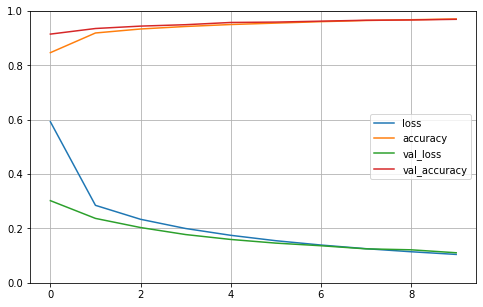

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
pd.DataFrame(history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix,classification_report
# Confusion Matrix
y_pred_valid = np.argmax(model.predict(X_valid), axis=-1)
print("y valid predicted shape", y_pred_valid.shape)
# true_labels = np.argmax(y_valid, axis=0)
print("y valid true shape", y_valid.shape)
print(confusion_matrix(y_pred_valid, y_valid))
print(classification_report(y_pred_valid, y_valid))

y valid predicted shape (5000,)
y valid true shape (5000,)
[[470   0   2   0   0   0   2   2   0   3]
 [  0 553   4   1   2   1   1   2   2   2]
 [  0   2 467   3   3   2   0   2   4   0]
 [  1   4   2 473   0   3   0   0   5   2]
 [  0   0   2   0 518   1   1   2   2   3]
 [  1   1   0   6   0 421   3   1   5   2]
 [  4   0   3   1   5   5 492   0   1   1]
 [  1   0   3   4   0   0   0 536   1   5]
 [  0   2   5   3   2   1   2   1 441   1]
 [  2   1   0   2   5   0   0   4   1 476]]
              precision    recall  f1-score   support

           0       0.98      0.98      0.98       479
           1       0.98      0.97      0.98       568
           2       0.96      0.97      0.96       483
           3       0.96      0.97      0.96       490
           4       0.97      0.98      0.97       529
           5       0.97      0.96      0.96       440
           6       0.98      0.96      0.97       512
           7       0.97      0.97      0.97       550
           8       0.95

In [ ]:
X_new = X_test[:4]
y_proba = model.predict(X_new)
y_proba.round(2)

array([[0.  , 0.  , 0.  , 0.01, 0.  , 0.  , 0.  , 0.99, 0.  , 0.  ],
       [0.  , 0.  , 0.99, 0.01, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
       [0.  , 0.99, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
       [1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ]],
      dtype=float32)

In [ ]:
y_pred = np.argmax(model.predict(X_new), axis=-1)
y_pred

array([7, 2, 1, 0])

In [ ]:
y_test_new = y_test[:4]

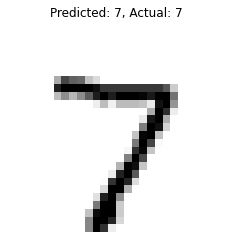

------------------------------------------------------------


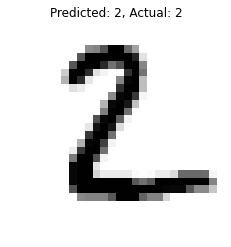

------------------------------------------------------------


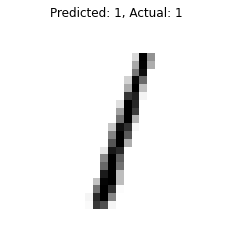

------------------------------------------------------------


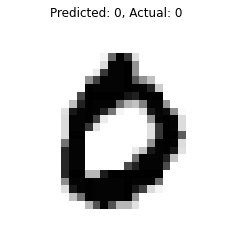

------------------------------------------------------------


In [ ]:
for data, pred, actual in zip(X_new, y_pred, y_test_new):
    plt.imshow(data, cmap="binary")
    plt.title(f"Predicted: {pred}, Actual: {actual}")
    plt.axis('off')
    plt.show()
    print("---"*20)

In [ ]:
weights, biases = hidden1.get_weights()
weights

array([[ 7.2692961e-02, -5.9923030e-02, -4.0352058e-02, ...,
         4.5492023e-02, -5.7890963e-02,  1.9952804e-03],
       [-1.7905265e-02, -3.1016856e-02,  6.9783613e-02, ...,
        -5.9587535e-02, -5.7161368e-02,  4.3021217e-02],
       [ 5.2395940e-02, -1.4383554e-02, -3.4959588e-02, ...,
        -5.9855748e-02, -5.4124117e-02,  7.2607666e-02],
       ...,
       [ 1.2033507e-03,  5.1443279e-04,  3.8285278e-02, ...,
         3.0062348e-04, -7.1440697e-02,  5.4505035e-02],
       [ 2.0485967e-03, -5.3515427e-02,  6.5640643e-02, ...,
        -6.3600883e-02, -5.9546027e-02, -6.4634874e-02],
       [ 2.4834163e-02, -7.4356087e-02, -5.7846367e-02, ...,
        -5.4381385e-02,  1.8961728e-05, -6.0168378e-02]], dtype=float32)

In [ ]:
biases

array([ 8.38191481e-04, -9.06544458e-03,  5.16560003e-02, -5.92335081e-03,
        1.71104781e-02,  7.35705392e-03, -2.13486999e-02,  3.15484852e-02,
        2.61750668e-02,  4.20935601e-02,  4.44389358e-02,  3.51986885e-02,
        2.47052033e-02,  5.99171408e-02,  3.24969590e-02,  1.49041112e-03,
        5.73331583e-03, -2.93819811e-02,  2.46198004e-04,  7.64467344e-02,
        4.92593180e-03, -5.19386586e-03, -2.36501098e-02,  1.73314679e-02,
       -2.00696290e-04, -1.11573711e-02,  1.30158272e-02, -1.39120873e-02,
        5.11514302e-03,  1.50961308e-02, -1.81635693e-02, -2.06535757e-02,
        7.82708917e-03, -5.98123251e-03, -1.12066623e-02, -8.10844731e-03,
        1.03073549e-02,  5.82028143e-02,  2.85325143e-02, -1.26739806e-02,
        2.91088521e-02,  1.77906342e-02,  5.51794060e-02,  7.14299688e-03,
        1.10262318e-03,  5.42575074e-03,  1.08933169e-02,  1.38897309e-02,
        4.78331596e-02, -1.56210095e-03,  4.46323343e-02,  4.00055060e-03,
       -7.21846102e-03,  

### **Tensorboard Callback**

In [ ]:
def get_log_path(log_dir="logs/fit"):
  fileName = time.strftime("log_%Y_%m_%d_%H_%M_%S")
  log_path = os.path.join(log_dir, fileName)
  print(f"saving logs at: {log_path}")
  return log_path

log_dir = get_log_path()

tb_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir)

saving logs at: logs/fit/log_2021_05_24_03_06_28


### **Early Stopping Callback**

In [ ]:
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True)

In [ ]:
%%time
valid_set = (X_valid, y_valid)

history = model.fit(X_train, y_train, epochs=30,
                    validation_data=valid_set, batch_size=32,
                    callbacks = [tb_cb,
                                 early_stopping_cb])

Epoch 1/30
1719/1719 [==============================] - 4s 2ms/step - loss: 0.0963 - accuracy: 0.9732 - val_loss: 0.1058 - val_accuracy: 0.9706
Epoch 2/30
1719/1719 [==============================] - 4s 2ms/step - loss: 0.0888 - accuracy: 0.9757 - val_loss: 0.1009 - val_accuracy: 0.9708
Epoch 3/30
1719/1719 [==============================] - 3s 2ms/step - loss: 0.0824 - accuracy: 0.9775 - val_loss: 0.0971 - val_accuracy: 0.9742
Epoch 4/30
1719/1719 [==============================] - 4s 2ms/step - loss: 0.0763 - accuracy: 0.9789 - val_loss: 0.0960 - val_accuracy: 0.9724
Epoch 5/30
1719/1719 [==============================] - 3s 2ms/step - loss: 0.0710 - accuracy: 0.9807 - val_loss: 0.0896 - val_accuracy: 0.9746
Epoch 6/30
1719/1719 [==============================] - 3s 2ms/step - loss: 0.0665 - accuracy: 0.9820 - val_loss: 0.0876 - val_accuracy: 0.9764
Epoch 7/30
1719/1719 [==============================] - 4s 2ms/step - loss: 0.0620 - accuracy: 0.9833 - val_loss: 0.0862 - val_accuracy:

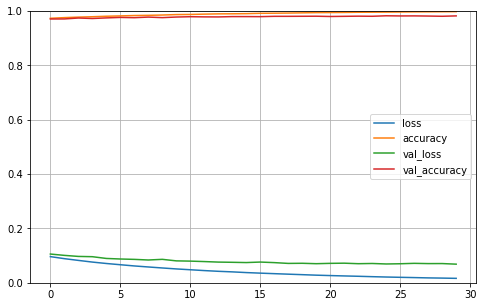

In [ ]:
pd.DataFrame(history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

# **Hyperparameter Tuning**

One of the most common optimization algorithms is Stochastic Gradient Descent (SGD). The hyperparameters that can be optimized in SGD are l**earning rate, momentum, decay** and **nesterov**



*   Learning rate controls the weight at the end of each batch
*   momentum controls how much to let the previous update influence the current weight update
*   Decay indicates the learning rate decay over each update
*   nesterov takes the value “True” or “False” depending on if we want to apply Nesterov momentum

Typical values for those hyperparameters are lr=0.01, decay=1e-6, momentum=0.9, and nesterov=True.

lr=lr×1/(1+decay∗epoch)

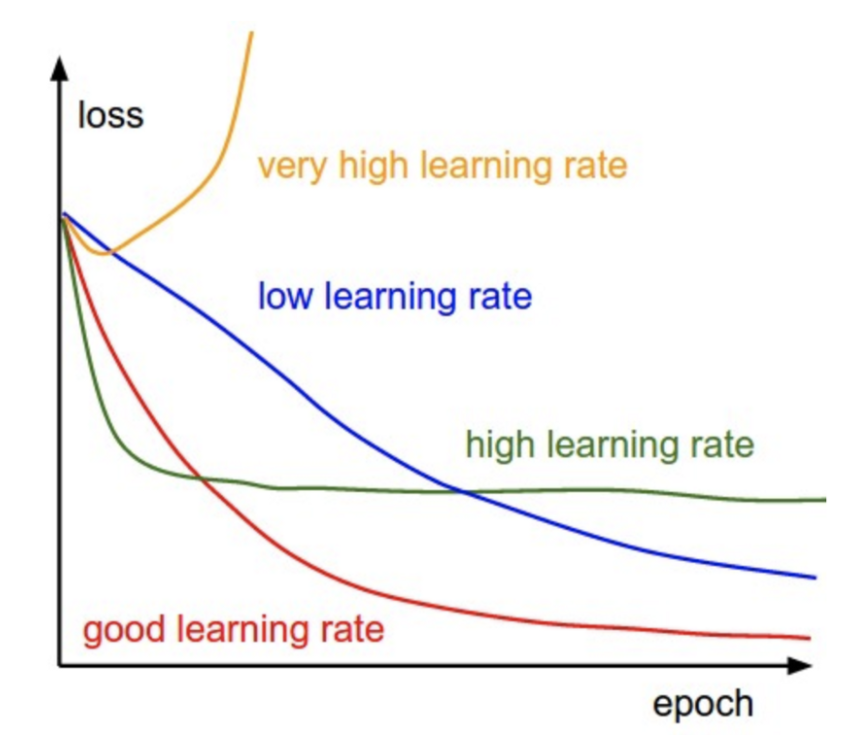

In [ ]:
Image(filename='/content/drive/MyDrive/Keras_Tutorial/learning_rate_image.PNG',width=600, height=400)

In [ ]:
from keras.optimizers import SGD
epochs = 30
learning_rate = 0.1
decay_rate = learning_rate / epochs
momentum = 0.8

# optimizer = "SGD"
sgd = SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)

In [ ]:
input_dim = X_train.shape[1]
input_dim
print(X_train.shape)

(55000, 28, 28)


In [ ]:
# build the model
from keras.layers import Dropout
lr_model = tf.keras.models.Sequential()
lr_model.add(tf.keras.layers.Flatten(input_shape=[28, 28])) # Input layer
lr_model.add(tf.keras.layers.Dense(300, activation="relu"))
lr_model.add(Dropout(0.1))
lr_model.add(tf.keras.layers.Dense(100, activation="relu"))
lr_model.add(tf.keras.layers.Dense(10, activation="softmax"))

In [ ]:
lr_model.layers

In [ ]:
# compile the model
lr_model.compile(loss='sparse_categorical_crossentropy',
              optimizer=sgd,
              metrics=['acc'])

In [ ]:
lr_model

In [ ]:
# Fit the model
%%time
batch_size = 78
valid_set = (X_valid, y_valid)

lr_model_history = lr_model.fit(X_train, y_train,
                                batch_size = batch_size,
                                epochs = 10,
                                verbose=1,
                                validation_data = valid_set)

Epoch 1/10
706/706 [==============================] - 2s 2ms/step - loss: 0.0535 - acc: 0.9835 - val_loss: 0.0714 - val_acc: 0.9788
Epoch 2/10
706/706 [==============================] - 2s 2ms/step - loss: 0.0518 - acc: 0.9844 - val_loss: 0.0706 - val_acc: 0.9796
Epoch 3/10
706/706 [==============================] - 2s 2ms/step - loss: 0.0496 - acc: 0.9851 - val_loss: 0.0703 - val_acc: 0.9790
Epoch 4/10
706/706 [==============================] - 2s 2ms/step - loss: 0.0490 - acc: 0.9861 - val_loss: 0.0695 - val_acc: 0.9796
Epoch 5/10
706/706 [==============================] - 2s 2ms/step - loss: 0.0479 - acc: 0.9855 - val_loss: 0.0696 - val_acc: 0.9788
Epoch 6/10
706/706 [==============================] - 2s 2ms/step - loss: 0.0462 - acc: 0.9864 - val_loss: 0.0692 - val_acc: 0.9796
Epoch 7/10
706/706 [==============================] - 2s 2ms/step - loss: 0.0447 - acc: 0.9871 - val_loss: 0.0685 - val_acc: 0.9796
Epoch 8/10
706/706 [==============================] - 2s 2ms/step - loss: 0.

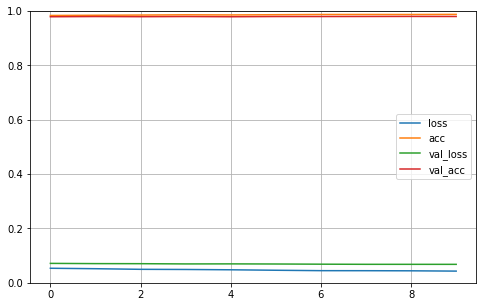

In [ ]:
pd.DataFrame(lr_model_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

### **Apply a custom learning rate change using LearningRateScheduler**

Write a function that performs the exponential learning rate decay as indicated by the following formula:
𝑙𝑟=𝑙𝑟₀ × 𝑒^(−𝑘𝑡)

In [ ]:
from keras.callbacks import LearningRateScheduler
from keras.callbacks import History

# solution
epochs = 10
learning_rate = 0.1 # initial learning rate
decay_rate = 0.1
momentum = 0.8
batch_size = 196

# define the optimizer function
sgd = SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)


# build the model
exponential_decay_model_history = tf.keras.models.Sequential()
exponential_decay_model_history.add(tf.keras.layers.Flatten(input_shape=[28, 28])) # Input layer
exponential_decay_model_history.add(tf.keras.layers.Dense(300, activation="relu"))
exponential_decay_model_history.add(Dropout(0.1))
exponential_decay_model_history.add(tf.keras.layers.Dense(100, activation="relu"))
exponential_decay_model_history.add(tf.keras.layers.Dense(10, activation="softmax"))

# compile the model
exponential_decay_model_history.compile(loss='sparse_categorical_crossentropy',
              optimizer=sgd,
              metrics=['acc'])

# define the learning rate change
def exp_decay(epoch):
    lrate = learning_rate * np.exp(-decay_rate*epoch)
    return lrate

# learning schedule callback
loss_history = History()
lr_rate = LearningRateScheduler(exp_decay)
callbacks_list = [loss_history, lr_rate]

exponential_decay_model_history = exponential_decay_model_history.fit(X_train, y_train,
                                                                      batch_size = batch_size,
                                                                      epochs = epochs,
                                                                      callbacks=callbacks_list,
                                                                      verbose=1,
                                                                      validation_data = valid_set)

Epoch 1/10
281/281 [==============================] - 1s 3ms/step - loss: 0.6992 - acc: 0.7955 - val_loss: 0.3090 - val_acc: 0.9166
Epoch 2/10
281/281 [==============================] - 1s 3ms/step - loss: 0.3448 - acc: 0.9020 - val_loss: 0.2886 - val_acc: 0.9218
Epoch 3/10
281/281 [==============================] - 1s 3ms/step - loss: 0.3283 - acc: 0.9079 - val_loss: 0.2789 - val_acc: 0.9238
Epoch 4/10
281/281 [==============================] - 1s 3ms/step - loss: 0.3218 - acc: 0.9077 - val_loss: 0.2741 - val_acc: 0.9244
Epoch 5/10
281/281 [==============================] - 1s 3ms/step - loss: 0.3112 - acc: 0.9100 - val_loss: 0.2706 - val_acc: 0.9268
Epoch 6/10
281/281 [==============================] - 1s 3ms/step - loss: 0.3163 - acc: 0.9101 - val_loss: 0.2681 - val_acc: 0.9272
Epoch 7/10
281/281 [==============================] - 1s 3ms/step - loss: 0.3096 - acc: 0.9103 - val_loss: 0.2663 - val_acc: 0.9278
Epoch 8/10
281/281 [==============================] - 1s 3ms/step - loss: 0.

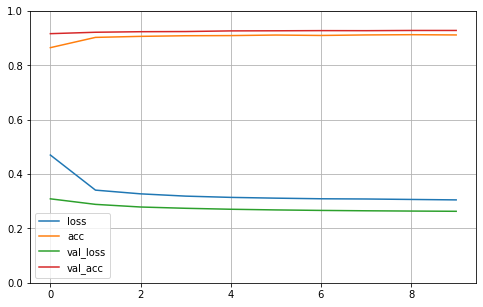

In [ ]:
pd.DataFrame(exponential_decay_model_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [ ]:
print(exp_decay(1))
print(exp_decay(2))
print(exp_decay(3))

0.09048374180359596
0.0818730753077982
0.0740818220681718


### **Choosing an optimizer and a loss function**

In [ ]:
from keras.optimizers import RMSprop

# build the model
model_opt = tf.keras.models.Sequential()
model_opt.add(tf.keras.layers.Flatten(input_shape=[28, 28])) # Input layer
model_opt.add(tf.keras.layers.Dense(300, activation="relu"))
model_opt.add(Dropout(0.1))
model_opt.add(tf.keras.layers.Dense(100, activation="relu"))
model_opt.add(tf.keras.layers.Dense(10, activation="softmax"))

# defining the parameters for RMSprop (I used the keras defaults here)
rms = RMSprop(lr=0.001, rho=0.9, epsilon=None, decay=0.0)

# compile the model
model_opt.compile(loss='sparse_categorical_crossentropy',
              optimizer = rms,
              metrics=['acc'])

model_opt_history = model_opt.fit(X_train, y_train,
                                  batch_size = 100,
                                  epochs = 10,
                                  validation_data = valid_set)

Epoch 1/10
550/550 [==============================] - 2s 3ms/step - loss: 0.4433 - acc: 0.8689 - val_loss: 0.1179 - val_acc: 0.9656
Epoch 2/10
550/550 [==============================] - 1s 2ms/step - loss: 0.1160 - acc: 0.9649 - val_loss: 0.0848 - val_acc: 0.9750
Epoch 3/10
550/550 [==============================] - 1s 2ms/step - loss: 0.0762 - acc: 0.9764 - val_loss: 0.0868 - val_acc: 0.9722
Epoch 4/10
550/550 [==============================] - 1s 2ms/step - loss: 0.0595 - acc: 0.9822 - val_loss: 0.0792 - val_acc: 0.9768
Epoch 5/10
550/550 [==============================] - 1s 2ms/step - loss: 0.0486 - acc: 0.9852 - val_loss: 0.0703 - val_acc: 0.9804
Epoch 6/10
550/550 [==============================] - 1s 2ms/step - loss: 0.0386 - acc: 0.9883 - val_loss: 0.0685 - val_acc: 0.9816
Epoch 7/10
550/550 [==============================] - 1s 2ms/step - loss: 0.0334 - acc: 0.9893 - val_loss: 0.0692 - val_acc: 0.9806
Epoch 8/10
550/550 [==============================] - 1s 2ms/step - loss: 0.

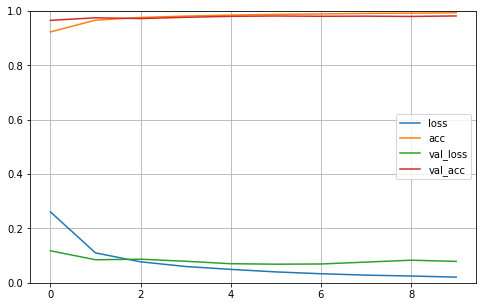

In [ ]:
pd.DataFrame(model_opt_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

### **Deciding on the batch size and number of epochs**

The batch size defines the number of samples that will be propagated through the network.

For instance, let’s say you have 1000 training samples and you want to set up a batch_size equal to 100. The algorithm takes the first 100 samples (from 1st to 100th) from the training dataset and trains the network. Next, it takes the second 100 samples (from 101st to 200th) and trains the network again. We can keep doing this procedure until we have propagated all samples through the network.

**Advantages** of using a batch size < number of all samples:

It requires less memory. Since you train the network using fewer samples, the overall t
training procedure requires less memory. That’s especially important if you are not able to fit the whole dataset in your machine’s memory.

Typically networks train faster with mini-batches. That’s because we update the weights after each propagation.

**Disadvantages** of using a batch size < number of all samples:

The smaller the batch the less accurate the estimate of the gradient will be.

The **number of epochs** is a hyperparameter that defines the number times that the learning algorithm will work through the entire training dataset

There are no hard and fast rules for selecting batch sizes or the number of epochs, and there is no guarantee that increasing the number of epochs provides a better result than a lesser number

In [ ]:
%%time
# batch_size = input_dim
epochs = 30

# build the model
model_epoch = tf.keras.models.Sequential()
model_epoch.add(tf.keras.layers.Flatten(input_shape=[28, 28])) # Input layer
model_epoch.add(tf.keras.layers.Dense(300, activation="relu"))
model_epoch.add(Dropout(0.1))
model_epoch.add(tf.keras.layers.Dense(100, activation="relu"))
model_epoch.add(tf.keras.layers.Dense(10, activation="softmax"))

# defining the parameters for RMSprop (I used the keras defaults here)
rms = RMSprop(lr=0.001, rho=0.9, epsilon=None, decay=0.0)

# compile the model
model_epoch.compile(loss='sparse_categorical_crossentropy',
                    optimizer = rms,
                    metrics=['acc'])

model_epoch_history = model_epoch.fit(X_train, y_train,
                                  batch_size = 100,
                                  epochs=epochs,
                                  validation_data = valid_set)

Epoch 1/30
550/550 [==============================] - 2s 3ms/step - loss: 0.4427 - acc: 0.8646 - val_loss: 0.1084 - val_acc: 0.9668
Epoch 2/30
550/550 [==============================] - 1s 2ms/step - loss: 0.1112 - acc: 0.9664 - val_loss: 0.0848 - val_acc: 0.9760
Epoch 3/30
550/550 [==============================] - 1s 2ms/step - loss: 0.0759 - acc: 0.9769 - val_loss: 0.0874 - val_acc: 0.9740
Epoch 4/30
550/550 [==============================] - 1s 2ms/step - loss: 0.0606 - acc: 0.9812 - val_loss: 0.0726 - val_acc: 0.9780
Epoch 5/30
550/550 [==============================] - 1s 2ms/step - loss: 0.0483 - acc: 0.9858 - val_loss: 0.0705 - val_acc: 0.9796
Epoch 6/30
550/550 [==============================] - 1s 2ms/step - loss: 0.0393 - acc: 0.9877 - val_loss: 0.0726 - val_acc: 0.9806
Epoch 7/30
550/550 [==============================] - 1s 2ms/step - loss: 0.0341 - acc: 0.9892 - val_loss: 0.0742 - val_acc: 0.9788
Epoch 8/30
550/550 [==============================] - 1s 2ms/step - loss: 0.

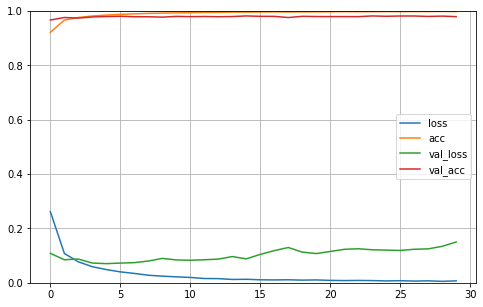

In [ ]:
pd.DataFrame(model_epoch_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

### **Random restarts**
This method does not seem to have an implementation in keras. It can be done easily by altering keras.callbacks.LearningRateScheduler

### **Tuning Hyperparameters using Cross-Validation - GridSearchCV**

To do cross-validation with keras we will use the wrappers for the Scikit-Learn API. They provide a way to use Sequential Keras models (single-input only) as part of your Scikit-Learn workflow.

keras.wrappers.scikit_learn.KerasClassifier(build_fn=None, **sk_params), which implements the Scikit-Learn classifier interface,

keras.wrappers.scikit_learn.KerasRegressor(build_fn=None, **sk_params), which implements the Scikit-Learn regressor interface.

In [ ]:
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasClassifier

**Trying Different Weight Initializations**

In [ ]:
# let's create a function that creates the model (required for KerasClassifier)
# while accepting the hyperparameters we want to tune
# we also pass some default values such as optimizer='rmsprop'

def create_model(optimizer='rmsprop', init='glorot_uniform'):

    # define model
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Flatten(input_shape=[28, 28])) # Input layer
    model.add(tf.keras.layers.Dense(300, activation="relu"))
    model.add(Dropout(0.1))
    model.add(tf.keras.layers.Dense(100, activation="relu"))
    model.add(tf.keras.layers.Dense(10, activation="softmax"))

    # compile model
    model.compile(loss='sparse_categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

    return model

In [ ]:
%%time
seed = 7
np.random.seed(seed)

# model_CV = KerasClassifier(build_fn = create_model, epochs=epochs,
#                            batch_size=batch_size, verbose=1)

# create the sklearn model for the network
model_init_batch_epoch_CV = KerasClassifier(build_fn=create_model,
                                            verbose=1)

# define the grid search parameters
# init_mode = ['uniform', 'lecun_uniform', 'normal', 'zero',
#              'glorot_normal', 'glorot_uniform', 'he_normal', 'he_uniform']

init_mode = ['glorot_uniform', 'uniform']
batches = [128, 512]
epochs = [10, 20]

param_grid = dict(epochs=epochs, batch_size=batches, init=init_mode)

grid = GridSearchCV(estimator = model_init_batch_epoch_CV,
                    param_grid=param_grid,
                    n_jobs=-1,
                    cv=3)
grid_result = grid.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py:691: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  "timeout or by a memory leak.", UserWarning


Epoch 1/20
430/430 [==============================] - 1s 2ms/step - loss: 0.4791 - accuracy: 0.8594
Epoch 2/20
430/430 [==============================] - 1s 2ms/step - loss: 0.1177 - accuracy: 0.9636
Epoch 3/20
430/430 [==============================] - 1s 2ms/step - loss: 0.0790 - accuracy: 0.9762
Epoch 4/20
430/430 [==============================] - 1s 2ms/step - loss: 0.0575 - accuracy: 0.9822
Epoch 5/20
430/430 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9864
Epoch 6/20
430/430 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9886
Epoch 7/20
430/430 [==============================] - 1s 3ms/step - loss: 0.0309 - accuracy: 0.9905
Epoch 8/20
430/430 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9919
Epoch 9/20
430/430 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9929
Epoch 10/20
430/430 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9942

In [ ]:
# print results
print(f'Best Accuracy for {grid_result.best_score_:.4} using {grid_result.best_params_}')
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print(f'mean={mean:.4}, std={stdev:.4} using {param}')

Best Accuracy for 0.977 using {'batch_size': 128, 'epochs': 20, 'init': 'uniform'}
mean=0.976, std=0.00134 using {'batch_size': 128, 'epochs': 10, 'init': 'glorot_uniform'}
mean=0.9744, std=0.001441 using {'batch_size': 128, 'epochs': 10, 'init': 'uniform'}
mean=0.9758, std=0.0005345 using {'batch_size': 128, 'epochs': 20, 'init': 'glorot_uniform'}
mean=0.977, std=0.0002715 using {'batch_size': 128, 'epochs': 20, 'init': 'uniform'}
mean=0.9738, std=0.001765 using {'batch_size': 512, 'epochs': 10, 'init': 'glorot_uniform'}
mean=0.9689, std=0.003695 using {'batch_size': 512, 'epochs': 10, 'init': 'uniform'}
mean=0.9761, std=0.001037 using {'batch_size': 512, 'epochs': 20, 'init': 'glorot_uniform'}
mean=0.9757, std=0.001084 using {'batch_size': 512, 'epochs': 20, 'init': 'uniform'}


One last question before we end: what do we do if the number of parameters and the number of values we have to cycle through in our GridSearchCV is particularly large?

This can be a particularly troublesome problem — imagine a situation where there are 5 parameters being selected for and 10 potential values that we have selected for each parameter. The number of unique combinations of this is 10⁵, which means we would have to train a ridiculously large number of networks. Clearly, it would be insanity to actually do it this way, so it is common to use RandomizedCV as an alternative.

RandomizedCV allows us to specify all of our potential parameters, and then for each fold in the cross-validation, it selects a random subset of parameters to use for the current model. In the end, the user can select the optimal set of parameters and use these as an approximate solution

# **Building the NN model from Scratch**

In [ ]:
# %matplotlib inline
from sklearn.datasets import fetch_openml
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
plt.style.use('ggplot')

In [ ]:
fetch_openml()

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split

In [ ]:
# #mnist
# mnist = fetch_openml('mnist_784')
from sklearn.datasets import fetch_mldata
mnist = fetch_mldata('MNIST original')
X, y = mnist["data"], mnist["target"]

X = X / 255

In [ ]:
print("X Shape", X.shape)
print("y Shape", y.shape)

X Shape (70000, 784)
y Shape (1, 70000)


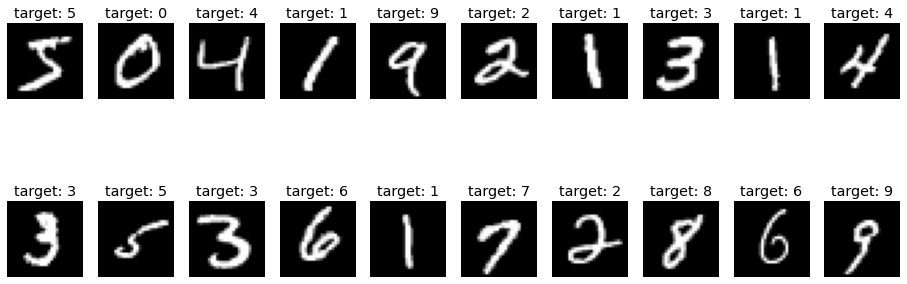

In [ ]:
fig, axes = plt.subplots(2, 10, figsize=(16, 6))
for i in range(20):
    axes[i//10, i %10].imshow(X[i].reshape((28,28)), cmap='gray');
    axes[i//10, i %10].axis('off')
    axes[i//10, i %10].set_title(f"target: {y[i]}")

## **Preprocessing**

**One hot Encode:**

In [ ]:
digits = 10
examples = y.shape[0]

y = y.reshape(1, examples)

Y_new = np.eye(digits)[y.astype('int32')]
Y_new = Y_new.T.reshape(digits, examples)

In [ ]:
Y_new.shape

(10, 70000)

**Splitting the data: Train and Test Split**

In [ ]:
m = 60000 #no of training samples or images
m_test = X.shape[0] - m

X_train, X_test = X[:m].T, X[m:].T
Y_train, Y_test = Y_new[:,:m], Y_new[:,m:]

print("X without transpose shape",X[:m].shape)
print("X Train shape", X_train.shape)
print("X Test shape", X_train.shape)
print("Y Train shape", Y_train.shape)
print("Y Test shape", Y_test.shape)

X without transpose shape (60000, 784)
X Train shape (784, 60000)
X Test shape (784, 60000)
Y Train shape (10, 60000)
Y Test shape (10, 10000)


**Show a image:**

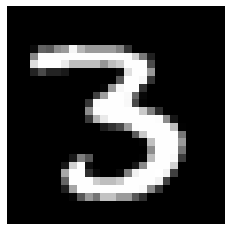

array([0., 0., 0., 1., 0., 0., 0., 0., 0., 0.])

In [ ]:
i = 12
plt.imshow(X_train[:,i].reshape(28,28), cmap = "gray")
plt.axis("off")
plt.show()
Y_train[:,i]

**Implementing Sigmoid Activation Function:**

In [ ]:
# sigmoid activation
def sigmoid(x):
  return 1. / (1.+np.exp(-x))

# relu activation
def relu(z):
    return np.maximum(0, z)

**Cross-entropy Loss (a.k.a Cost, Error) Function**

In [ ]:
#cross-entropy for our cost function
def compute_multiclass_loss(Y, Y_hat):
    L_sum = np.sum(np.multiply(Y, np.log(Y_hat)))
    m = Y.shape[1]
    L = -(1/m) * L_sum
    return L

In [ ]:
# def entropy_loss(self,y, yhat):
#     nsample = len(y)
#     yhat_inv = 1.0 - yhat
#     y_inv = 1.0 - y
#     yhat = self.eta(yhat) ## clips value to avoid NaNs in log
#     yhat_inv = self.eta(yhat_inv)
#     loss = -1/nsample * (np.sum(np.multiply(np.log(yhat), y) + np.multiply((y_inv), np.log(yhat_inv))))
#     return loss

In [ ]:
n_x = X_train.shape[0]
print(n_x)
n_h = 64
print(n_h)
digits = 10 # target column
learning_rate = 0.1
epochs = 2000

784
64


**Initializing Weights and bias:**

In [ ]:
W1 = np.random.randn(n_h, n_x)
b1 = np.zeros((n_h, 1))
W2 = np.random.randn(digits, n_h)
b2 = np.zeros((digits, 1))

X = X_train
Y = Y_train

In [ ]:
print(X.shape)
print(W1.shape)
print(W2.shape)
print(Y.shape)

(784, 60000)
(64, 784)
(10, 64)
(10, 60000)


**Training the model**

In [ ]:
%%time
for i in range(epochs):
  Z1 = np.matmul(W1,X) + b1 # 1st hidden layer
  A1 = relu(Z1)
  Z2 = np.matmul(W2,A1) + b2 # 2nd hidden layer
  A2 = np.exp(Z2) / np.sum(np.exp(Z2), axis=0) # Softmax

  cost = compute_multiclass_loss(Y, A2)

  # Derivatives
  dZ2 = A2-Y
  dW2 = (1./m) * np.matmul(dZ2, A1.T)
  db2 = (1./m) * np.sum(dZ2, axis=1, keepdims=True)

  dA1 = np.matmul(W2.T, dZ2)
  dZ1 = dA1 * sigmoid(Z1) * (1 - sigmoid(Z1))
  dW1 = (1./m) * np.matmul(dZ1, X.T)
  db1 = (1./m) * np.sum(dZ1, axis=1, keepdims=True)

  # Update the weights
  W2 = W2 - learning_rate * dW2
  b2 = b2 - learning_rate * db2
  W1 = W1 - learning_rate * dW1
  b1 = b1 - learning_rate * db1

  if (i % 100 == 0):
        print("Epoch", i, "cost: ", cost)

print("Final cost:", cost)

Epoch 0 cost:  95.40672284869422
Epoch 100 cost:  5.070397914934179
Epoch 200 cost:  3.1121093340300283
Epoch 300 cost:  2.8234400694513386
Epoch 400 cost:  2.786512318932117
Epoch 500 cost:  2.588108734102502
Epoch 600 cost:  2.397652448476476
Epoch 700 cost:  1.8462011456395087
Epoch 800 cost:  2.660645213501008
Epoch 900 cost:  2.1379014118060797
Epoch 1000 cost:  2.4973653726922835
Epoch 1100 cost:  1.9639384141148666
Epoch 1200 cost:  2.4447025964993636
Epoch 1300 cost:  1.5255292329395966
Epoch 1400 cost:  2.754750246920114
Epoch 1500 cost:  2.15189041035868
Epoch 1600 cost:  1.7971410719711574
Epoch 1700 cost:  1.685386770410479
Epoch 1800 cost:  3.361831481538883
Epoch 1900 cost:  1.981805889607915
Final cost: 1.3647823976105058
CPU times: user 46min 23s, sys: 7min 1s, total: 53min 25s
Wall time: 29min


**Predictions**

In [ ]:
%%time
Z1 = np.matmul(W1, X_test) + b1
A1 = sigmoid(Z1)
Z2 = np.matmul(W2, A1) + b2
A2 = np.exp(Z2) / np.sum(np.exp(Z2), axis=0)

predictions = np.argmax(A2, axis=0)
labels = np.argmax(Y_test, axis=0)

print(confusion_matrix(predictions, labels))
print(classification_report(predictions, labels))

[[346   0   2   8   1  13   5   9   4   6]
 [  9 984  49  51  25  39  18  29  61  58]
 [ 85  22 631  74  23  35  30  17  58  20]
 [ 34  12  20 446   2  63   2   4  16   5]
 [ 41   0  68  26 805  91  92  22 127 471]
 [311  16  49 198  33 436  51  13 127  21]
 [ 81  34 139  98  32  99 745  12 137  10]
 [ 46  56  59  58  47  46   9 907  64 225]
 [ 14   8  15  47   9  56   5   2 377  14]
 [ 13   3   0   4   5  14   1  13   3 179]]
              precision    recall  f1-score   support

           0       0.35      0.88      0.50       394
           1       0.87      0.74      0.80      1323
           2       0.61      0.63      0.62       995
           3       0.44      0.74      0.55       604
           4       0.82      0.46      0.59      1743
           5       0.49      0.35      0.41      1255
           6       0.78      0.54      0.64      1387
           7       0.88      0.60      0.71      1517
           8       0.39      0.69      0.50       547
           9       0.18     